In [1]:
from matplotlib import pyplot as plt
from scipy.cluster.hierarchy import dendrogram
from scipy.cluster.hierarchy import linkage, fcluster
from sklearn import cluster
from sklearn import preprocessing
from sklearn.cluster import AgglomerativeClustering
from sklearn.cluster import KMeans
from sklearn.datasets import make_blobs
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.metrics.cluster import adjusted_rand_score
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import MinMaxScaler, QuantileTransformer, LabelEncoder, StandardScaler
from sklearn.preprocessing import StandardScaler
import datetime as dt
import matplotlib.cm as cm
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns

import warnings
warnings.simplefilter(action='ignore', category=Warning)

from IPython.display import Audio
sound_file = '/Users/soso/Downloads/bell.mp3'
sound_file_1 = '/Users/soso/Downloads/Batterie de blague.mp3.mp3'


km_base = KMeans(n_clusters=5, random_state=0, n_init=50)

# Create DATA ALL

## Importation csv

In [2]:
mBase = pd.read_csv('Prepare_donnée_brute.csv')
mBase.drop("Unnamed: 0", inplace=True, axis=1)
mBase.drop("Distance", inplace=True, axis=1)
mBase__ = mBase.copy()
mBase__

,customer_unique_id,Product_count,review_score_mean,product_category_name,Coord,Recenc_,Frequency_,Monetary_
0,24ac2b4327e25baf39f2119e4228976a,1.0,5.0,Hi_Tech,CS,5.0,1,93.75
1,b701bebbdf478f5500348f03aff62121,1.0,3.0,Maison,CS,5.0,1,33.23
2,5c58de6fb80e93396e2f35642666b693,2.0,5.0,Maison,CS,5.0,1,510.96
3,7febafa06d9d8f232a900a2937f04338,1.0,5.0,Maison,CC,5.0,1,61.29
4,7a22d14aa3c3599238509ddca4b93b01,1.0,1.0,Divers,CS,5.0,1,73.10
...,...,...,...,...,...,...,...,...
91604,8d3a54507421dbd2ce0a1d58046826e0,1.0,1.0,Maison,CS,700.0,1,133.46
91605,88bc832f104b6dd684a17dbb1b76e778,1.0,1.0,Service_Outils,CS,700.0,1,114.77
91606,87776adb449c551e74c13fc34f036105,1.0,5.0,Maison,ES,700.0,1,40.95
91607,b8b8726af116a5cfb35b0315ecef9172,1.0,1.0,Culture_Loisir,ES,700.0,1,35.61


# CHOIX VARIABLE

In [3]:
mBase_1 = mBase[['Product_count','review_score_mean','Recenc_','Frequency_','Monetary_']]
mBase_2 = mBase[['product_category_name','Coord']]

# LOG

In [4]:

mBase_1_0 = np.log(mBase_1)

# STANDARD SCAL

In [5]:

std_scale = preprocessing.StandardScaler().fit(mBase_1_0)
X_scaled = std_scale.transform(mBase_1_0)
mBase_1_0 = pd.DataFrame(X_scaled)

# DUMMIES

In [6]:

mAllDum = pd.get_dummies(mBase_2)
mAllDum = mAllDum.reset_index()
mAllDum.drop("index", inplace=True, axis=1)
mBase_2_0 = mAllDum.copy()

#JOINT

In [7]:

mBase_ = mBase_1_0.join(mBase_2_0)
#mBase_.to_csv('data_after_dummies_sdtScal.csv')

#PCA 

Text(0, 0.5, 'Expl variance')

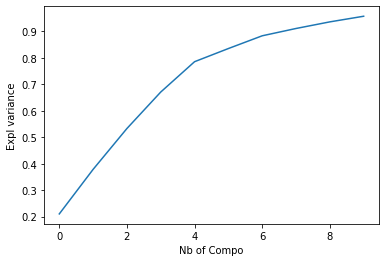

In [9]:

pca = PCA(n_components=10)
principalComponents = pca.fit_transform(mBase_)
pca_ex = pca.components_




# GRAPH NB COMPO

In [ ]:

plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('Nb of Compo')
plt.ylabel('Expl variance')

# GRAPH IMPORTANT VARIABLE

([<matplotlib.axis.XTick at 0x7ff7ba4aaa30>,
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

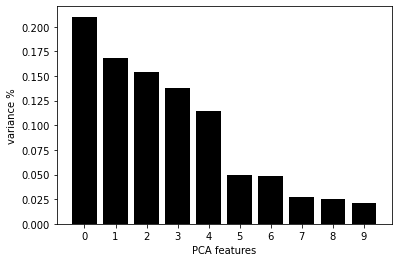

In [10]:

features = range(pca.n_components_)
plt.bar(features, pca.explained_variance_ratio_, color='black')
plt.xlabel('PCA features')
plt.ylabel('variance %')
plt.xticks(features)

# 1er Graph 

Text(0, 0.5, 'PCA 2')

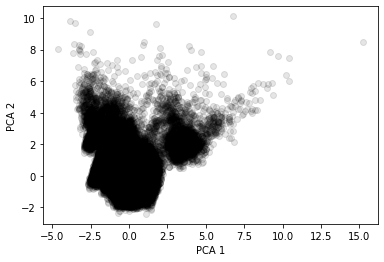

In [11]:

PCA_components = pd.DataFrame(principalComponents)
plt.scatter(PCA_components[1], PCA_components[0], alpha=.1, color='black')
plt.xlabel('PCA 1')
plt.ylabel('PCA 2')

In [12]:
#ByPASS -- BEST CLUSTER 4

#for i in range (3,8):
#    k_means = KMeans(n_clusters=i, random_state=0)
#    k_means_fit = k_means.fit(mBase_)
#    silhouette_avg = silhouette_score(mBase_, k_means_fit.labels_)
#    print(i, "The mBase_ silhouette_score is :", silhouette_avg)


# KMEAN _ PCA 

In [13]:

pca_ = PCA(n_components=6)
principalComponents_ = pca_.fit_transform(mBase_)
_kMeans_pca = km_base.fit(principalComponents_)

array([[-0.72682846,  1.99169114, -3.52076243,  0.25587359, -0.05524939,
        -0.13588304],
       [-1.09082824,  1.12769518, -3.79754908,  1.2943723 ,  0.61284797,
        -0.55487042],
       [ 2.21868785,  1.85053323, -3.90508   , -1.42110834,  0.1388508 ,
        -0.60571214],
       ...,
       [-1.13789132, -0.68123289,  1.39441017, -0.21192437,  0.67719096,
         0.43979742],
       [-0.1266538 , -2.59700862,  0.77711963,  2.14682023,  0.23599127,
         0.66572843],
       [-1.20182497, -0.64263044,  1.34972873, -0.22906152,  0.75459284,
        -0.21238461]])

# Elbow Method

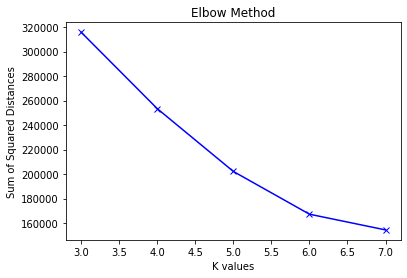

In [14]:

K = range(3,8)
sum_of_squared_distances = []
for k in K:
    model = KMeans(n_clusters=k).fit(principalComponents_)
    sum_of_squared_distances.append(model.inertia_)
plt.plot(K, sum_of_squared_distances, 'bx-')
plt.xlabel('K values')
plt.ylabel('Sum of Squared Distances')
plt.title('Elbow Method')
plt.show()

# Nb Cluster v1

In [15]:
#range_n_clusters = [2, 3, 4, 5, 6]
    
    
    
    
#for ind in [2,4,6,8,10]:
#    for n_clusters in range_n_clusters:
        
        #pca_ = PCA(n_components=ind)
        #principalComponents_ = pca_.fit_transform(mBase_)
        #_kMeans_pca = km_base.fit(principalComponents_)
        
        # Create a subplot with 1 row and 2 columns
        #fig, (ax1, ax2) = plt.subplots(1, 2)
        #fig.set_size_inches(18, 7)
    
        # The 1st subplot is the silhouette plot
        # The silhouette coefficient can range from -1, 1 but in this example all
        # lie within [-0.1, 1]
        #ax1.set_xlim([-0.1, 1])
        # The (n_clusters+1)*10 is for inserting blank space between silhouette
        # plots of individual clusters, to demarcate them clearly.
        #ax1.set_ylim([0, len(principalComponents_) + (n_clusters + 1) * 10])
    
        # Initialize the clusterer with n_clusters value and a random generator
        # seed of 10 for reproducibility.
        #clusterer = KMeans(n_clusters=n_clusters, random_state=10)
        #cluster_labels = clusterer.fit_predict(principalComponents_)
    
        # The silhouette_score gives the average value for all the samples.
        # This gives a perspective into the density and separation of the formed
        # clusters
        #silhouette_avg = silhouette_score(principalComponents_, cluster_labels)
        #print("For n_components =", ind)
        #print("For n_clusters =", n_clusters,"The average silhouette_score is :", silhouette_avg)
    
        # Compute the silhouette scores for each sample
        #sample_silhouette_values = silhouette_samples(principalComponents_, cluster_labels)
    
       # y_lower = 10
       #for i in range(n_clusters):
       #    # Aggregate the silhouette scores for samples belonging to
       #    # cluster i, and sort them
       #    ith_cluster_silhouette_values = \
       #    sample_silhouette_values[cluster_labels == i]
    
       #    ith_cluster_silhouette_values.sort()
    
       #    size_cluster_i = ith_cluster_silhouette_values.shape[0]
       #    y_upper = y_lower + size_cluster_i
    
       #    color = cm.nipy_spectral(float(i) / n_clusters)
       #    ax1.fill_betweenx(np.arange(y_lower, y_upper),
       #                      0, ith_cluster_silhouette_values,
       #                      facecolor=color, edgecolor=color, alpha=0.7)
    
       #    # Label the silhouette plots with their cluster numbers at the middle
       #    ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))
    
       #    # Compute the new y_lower for next plot
       #    y_lower = y_upper + 10  # 10 for the 0 samples
    
       #ax1.set_title("The silhouette plot for the various clusters.")
       #ax1.set_xlabel("The silhouette coefficient values")
       #ax1.set_ylabel("Cluster label")
    
        # The vertical line for average silhouette score of all the values
        #ax1.axvline(x=silhouette_avg, color="red", linestyle="--")
    
        #ax1.set_yticks([])  # Clear the yaxis labels / ticks
        #ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])
    
        # 2nd Plot showing the actual clusters formed
        #colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
        #ax2.scatter(principalComponents_[:, 0], principalComponents_[:, 1], marker='.', s=30, lw=0, alpha=0.7,           c=colors, edgecolor='k')
    
        # Labeling the clusters
        #centers = clusterer.cluster_centers_
        # Draw white circles at cluster centers
        #ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
        #           c="white", alpha=1, s=200, edgecolor='k')
    
        #for i, c in enumerate(centers):
        #    ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,s=50, edgecolor='k')
    
        #ax2.set_title("The visualization of the clustered data.")
        #ax2.set_xlabel("Feature space for the 1st feature")
        #ax2.set_ylabel("Feature space for the 2nd feature")
    
        #plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
        #              "with n_clusters = %d" % n_clusters),
        #             fontsize=14, fontweight='bold')
    
# plt.show()

# Nb Cluster v2

In [16]:
#range_n_clusters = [2, 3, 4, 5, 6]
#    
#    
#    
#    
#for ind in [2,4,6,8,10]:
#    for n_clusters in range_n_clusters:
#        pca_ = PCA(n_components=ind)
#        principalComponents_ = pca_.fit_transform(mBase_)
#        #_kMeans_pca = km_base.fit(principalComponents_)
#        clusterer = KMeans(n_clusters=n_clusters, random_state=10)
#        cluster_labels = clusterer.fit_predict(principalComponents_)
#        silhouette_avg = silhouette_score(principalComponents_, cluster_labels)
#        print("For n_components =", ind)
#        print("For n_clusters =", n_clusters,"The average silhouette_score is :", silhouette_avg)
#

# silhouette_score

In [17]:
#Verif Sil

silhouette_avg = silhouette_score(principalComponents_, _kMeans_pca.labels_)
print('silhouette_score is :', silhouette_avg)


silhouette_score is : 0.3285658060003701


In [18]:
Audio(sound_file, autoplay=True)

# Graph Cluster

<function matplotlib.pyplot.show(close=None, block=None)>

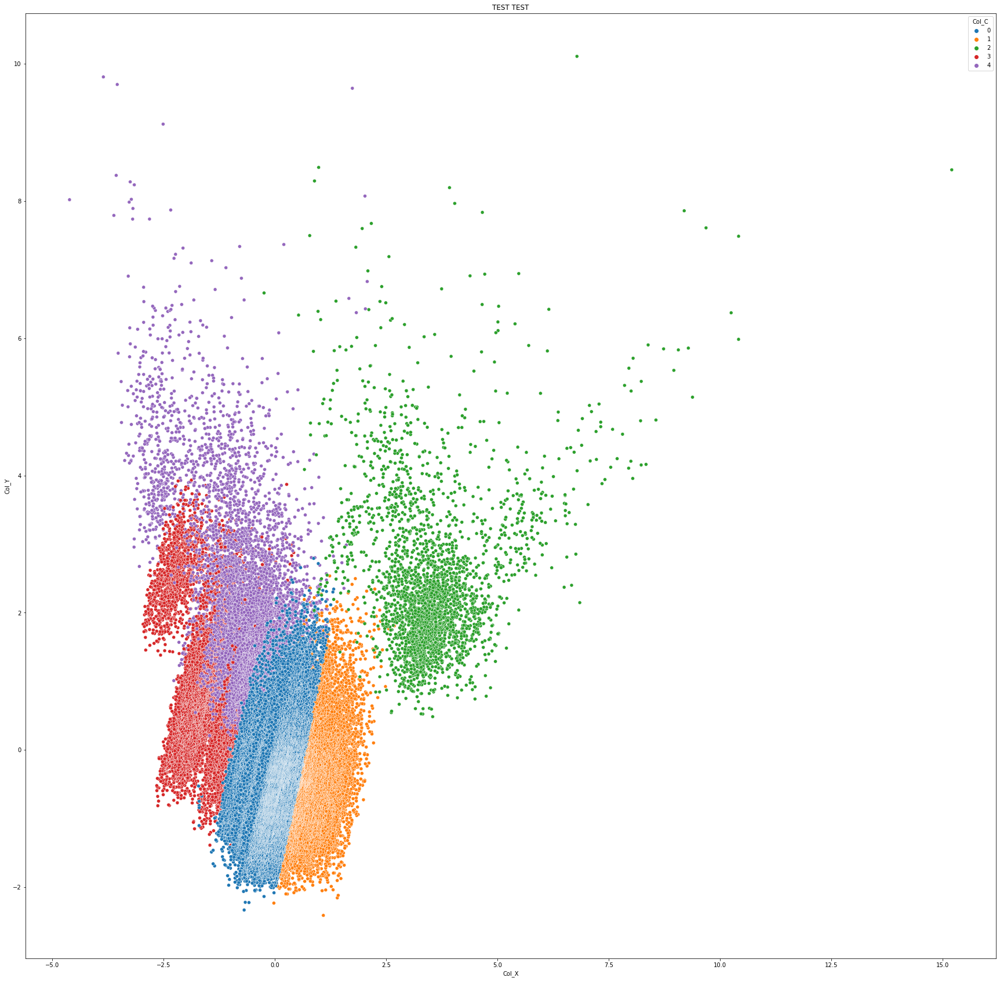

In [19]:

PCA_C = pd.DataFrame(_kMeans_pca.labels_)
PCA_X = PCA_components.iloc[:, 0:1]
PCA_Y = PCA_components.iloc[:, 1:2]
PCA_Z = PCA_components.iloc[:, 2:3]
PCA_for_Graph = PCA_Y.join(PCA_X)
PCA_for_Graph = PCA_for_Graph.join(PCA_Z)
PCA_for_Graph = PCA_for_Graph.reset_index()
PCA_C = PCA_C.reset_index()
PCA_for_Graph = pd.merge(PCA_for_Graph, PCA_C, on="index", how="left")
PCA_for_Graph.drop("index", inplace=True, axis=1)
PCA_for_Graph = PCA_for_Graph.rename(columns={"0_x": 'Col_Y',1 : 'Col_X',2 : 'Col_Z', "0_y":"Col_C"})
#PCA_for_Graph
plt.figure(figsize = (30,30))
sns.scatterplot(PCA_for_Graph["Col_X"], PCA_for_Graph["Col_Y"], hue= PCA_for_Graph['Col_C'], palette=("tab10"))
#plt.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], s=70, c='black', label='Centroids' )
plt.title("TEST TEST")
plt.show
#PCA_for_Graph



# Graph Cluster 3D

In [20]:
import plotly.express as px

fig = px.scatter_3d(PCA_for_Graph, x='Col_X', y='Col_Y', z='Col_Z',
              color='Col_C')
fig.show()

# Diagramme de Sankey

In [21]:
def kmeans_lab_for_X(cdc,rdm,t) : 

    mBase_1_0 = np.log(cdc[['Product_count','review_score_mean','Recenc_','Frequency_','Monetary_']])
    std_scale = preprocessing.StandardScaler().fit(mBase_1_0)
    X_scaled = std_scale.transform(mBase_1_0)
    mBase_1_0 = pd.DataFrame(X_scaled)
    
    mAllDum = pd.get_dummies(cdc[['product_category_name','Coord']])
    mAllDum = mAllDum.reset_index()
    mAllDum.drop("index", inplace=True, axis=1)
    mBase_2_0 = mAllDum.copy()
    
    mBase_ = mBase_1_0.join(mBase_2_0)
    
    km_base = KMeans(n_clusters=5, random_state=rdm, n_init=100)
    _kMeans_fit = km_base.fit(mBase_)
    lab = _kMeans_fit.labels_
    lab_df = pd.DataFrame(lab)
    lab_df = lab_df.join(mBase["Recenc_"])
    lab_df = lab_df.loc[(mBase['Recenc_'] < t)]
    lab_df = lab_df[0]
    lab_df = lab_df.to_numpy()
    return lab_df

In [22]:
mTestClus = kmeans_lab_for_X(mBase__,1,700)
mTestClus = pd.DataFrame(mTestClus)
mTestClus = mTestClus.join(mBase)
mTestClus.drop("customer_unique_id", inplace=True, axis=1)
mTestClus = mTestClus.rename(columns={0: 'Col_C'})
mTestClus

i = 0
def last_func_index(x1,y1):
    x1_ = pd.DataFrame(x1)
    x1_ = x1_.rename(columns={0: 'Col_X1'})
    y1_ = pd.DataFrame(y1)
    y1_ = y1_.rename(columns={0: 'Col_Y1'})
    X_Y_ = y1_.join(x1_)
    X_Y_["C4"] = X_Y_["Col_X1"]+10
    X_Y_['Col_X1'] = X_Y_['Col_X1'].astype(str)
    X_Y_['Col_Y1'] = X_Y_['Col_Y1'].astype(str)
    X_Y_['Col_X1_Y1'] = X_Y_['Col_X1'] + X_Y_['Col_Y1']
    a = X_Y_['Col_X1_Y1'].value_counts()
    a = a.reset_index()
    a = pd.DataFrame(a)
    a = a['index'].values
    return a


def last_func_counts(x1,y1):
    x1_ = pd.DataFrame(x1)
    x1_ = x1_.rename(columns={0: 'Col_X1'})
    y1_ = pd.DataFrame(y1)
    y1_ = y1_.rename(columns={0: 'Col_Y1'})
    X_Y_ = y1_.join(x1_)
    X_Y_["C4"] = X_Y_["Col_X1"]+10
    X_Y_['Col_X1'] = X_Y_['Col_X1'].astype(str)
    X_Y_['Col_Y1'] = X_Y_['Col_Y1'].astype(str)
    X_Y_['Col_X1_Y1'] = X_Y_['Col_X1'] + X_Y_['Col_Y1']
    a = X_Y_['Col_X1_Y1'].value_counts()
    a = a.reset_index()
    a = a['Col_X1_Y1'].values
    return a 

In [23]:

    
    
m06_t = mTestClus.loc[(mTestClus['Recenc_'] <= 150 )]
m07_t = mTestClus.loc[(mTestClus['Recenc_'] <= 300)]
m08_t = mTestClus.loc[(mTestClus['Recenc_'] <= 330)]
m09_t = mTestClus.loc[(mTestClus['Recenc_'] <= 400)]
m10_t = mTestClus.loc[(mTestClus['Recenc_'] <= 500)]

m06_new = mBase__.loc[(mBase__['Recenc_'] <= 150)]
m07_new = mBase__.loc[(mBase__['Recenc_'] <= 300)]
m08_new = mBase__.loc[(mBase__['Recenc_'] <= 330)]
m09_new = mBase__.loc[(mBase__['Recenc_'] <= 400)]
m10_new = mBase__.loc[(mBase__['Recenc_'] <= 500)]


m06_t = pd.DataFrame(m06_t["Col_C"])
m07_t = pd.DataFrame(m07_t["Col_C"])
m08_t = pd.DataFrame(m08_t["Col_C"])
m09_t = pd.DataFrame(m09_t["Col_C"])
m10_t = pd.DataFrame(m10_t["Col_C"])


def _mLabel_for_Time__(mBas_) : 
    mBase_1 = mBas_[['Product_count','review_score_mean','Recenc_','Frequency_','Monetary_']]
    mBase_2 = mBas_[['product_category_name','Coord']]
    #mBase_3 = mBas_["Distance"]
    mBase_1_0 = np.log(mBase_1)
    #mBase_1_0 = mBase_1.join(mBase_3)
    std_scale = preprocessing.StandardScaler().fit(mBase_1_0)
    X_scaled = std_scale.transform(mBase_1_0)
    mBase_1_0 = pd.DataFrame(X_scaled)
    mAllDum = pd.get_dummies(mBase_2)
    mAllDum = mAllDum.reset_index()
    mAllDum.drop("index", inplace=True, axis=1)
    mBase_2_0 = mAllDum.copy()
    mBase_ = mBase_1_0.join(mBase_2_0)
    pca_ = PCA(n_components=6)
    principalComponents_ = pca_.fit_transform(mBase_)
    #_kMeans_pca = km_base.fit(principalComponents_)
    _kMeans_pca = km_base.predict(principalComponents_)
    return _kMeans_pca

def func_new(m01_new):
    #m01_new.drop("customer_unique_id", inplace=True, axis=1)
    mX1 = pd.DataFrame(_mLabel_for_Time__(m01_new))
    mX1 = mX1[0]
    mX1 = mX1.to_numpy()
    return mX1

def func_old(m01_t):
    m01_t = pd.DataFrame(m01_t)
    m01_t = m01_t["Col_C"]
    m01_t = m01_t.to_numpy()
    return m01_t


x6= func_new(m06_new)

In [24]:
x6= func_new(m06_new)
x7= func_new(m07_new)
x8= func_new(m08_new)
x9= func_new(m09_new)
x10= func_new(m10_new)

y6= func_old(m06_t)
y7= func_old(m07_t)
y8= func_old(m08_t)
y9= func_old(m09_t)
y10= func_old(m10_t)

In [25]:
def_res = np.concatenate([last_func_counts(x6,y6), 
                last_func_counts(x7,y7), 
                last_func_counts(x8,y8),
                last_func_counts(x9,y9),
                last_func_counts(x10,y10)])


array([14365,  5570,  3390,  2499,  2219,  1035,   709,   131,   113,
          89,    12,     7, 30015, 12232,  7319,  5528,  4434,  2088,
         318,    87,    84,    78,     7,     2,     2, 33160, 12988,
        7781,  4841,  4787,  2220,   285,    69,    56,    47,     7,
           2,     2, 40235, 14752,  8628,  5738,  3046,  2506,   137,
          46,    37,    15,     7,     2, 48480, 16438,  9640,  6670,
        2796,  1381,    26,    25,    22,     4,     3,     3])

In [26]:
#print( "1------>" , last_func_index(x6,y6))
#print( "2------>" , last_func_index(x7,y7))
#print( "3------>" , last_func_index(x8,y8))
#print( "4------>" , last_func_index(x9,y9))
#print( "5------>" , last_func_index(x10,y10))

def_ind = np.concatenate([last_func_index(x6,y6), 
                last_func_index(x7,y7), 
                last_func_index(x8,y8),
                last_func_index(x9,y9),
                last_func_index(x10,y10)])


array(['02', '10', '12', '31', '43', '24', '00', '30', '03', '32', '33',
       '44', '00', '12', '31', '02', '43', '24', '13', '41', '32', '01',
       '33', '23', '44', '00', '12', '31', '43', '02', '24', '13', '32',
       '41', '01', '33', '23', '44', '00', '12', '31', '43', '02', '24',
       '13', '32', '01', '41', '33', '44', '00', '12', '31', '43', '24',
       '02', '01', '32', '13', '41', '33', '44'], dtype=object)

In [82]:
k = [14365,5570,3390,2499,2219,1035,709,131,113,89,12,7,30015,12232,7319,5528,4434,2088,318,87,84,78,7,2,2,33160,12988,7781,4841,4787,2220,285,69,56,47,7,2,2,40235,14752,8628,5738,3046,2506,137,46,37,15,7,2,48480,16438,9640,6670,2796,1381,26,25,22,4,3,3]
l = [0,1,1,3,4,2,0,3,0,3,3,4,10,11,13,10,14,12,11,14,13,10,13,12,14,20,21,23,24,22,22,21,23,24,20,23,22,24,30,31,33,34,30,32,31,33,30,34,33,34,40,41,43,44,42,40,40,43,41,44,43,44]
m = [12,10,12,11,13,14,10,10,13,12,13,14,20,22,21,22,23,24,23,21,22,21,23,23,24,30,32,31,33,30,34,33,32,31,31,33,33,34,40,42,41,43,42,44,43,42,41,41,43,44,50,52,51,53,54,52,51,52,53,51,53,54]

In [84]:
import plotly.graph_objects as go


#source = r
#target = s
#value =  t

link = dict(source = l, target = m, value = k)
data = go.Sankey(link = link)

fig = go.Figure(data)

fig.show()

# ANALYSE DES CLUSTERS

In [29]:
mCol_Name = mBase_.copy()
mCol_Name = mCol_Name.rename(columns={0:'Product_count', 
1:'review_score_mean',
2:'Recenc_',
3:'Frequency_',
4:'Monetary_'
#5:'Distance'
})

In [30]:
mExpl_var = pd.DataFrame(abs(pca_ex), columns=mCol_Name.columns)
mExpl_var = mExpl_var.T
mExpl_var = mExpl_var.rename(columns={0:'col_0', 1:'col_1', 2:'col_2',3:'col_3', 4:'col_4'})
mExpl_var_0 = pd.DataFrame(mExpl_var["col_0"])
mExpl_var_0 = mExpl_var_0.sort_values(by=['col_0'], ascending=False)
mExpl_var_1 = pd.DataFrame(mExpl_var["col_1"])
mExpl_var_1 = mExpl_var_1.sort_values(by=['col_1'], ascending=False)
mExpl_var_2 = pd.DataFrame(mExpl_var["col_2"])
mExpl_var_2 = mExpl_var_2.sort_values(by=["col_2"], ascending=False)
mExpl_var_3 = pd.DataFrame(mExpl_var["col_3"])
mExpl_var_3 = mExpl_var_3.sort_values(by=['col_3'], ascending=False)
mExpl_var_4 = pd.DataFrame(mExpl_var["col_4"])
mExpl_var_4 = mExpl_var_4.sort_values(by=['col_4'], ascending=False)


In [31]:
# TEST

In [32]:
mTestClus = PCA_for_Graph["Col_C"]
mTestClus = pd.DataFrame(mTestClus)
mTestClus = mTestClus.join(mBase)
mTestClus.drop("customer_unique_id", inplace=True, axis=1)


mClus_0 = mTestClus.loc[(mTestClus['Col_C'] == 0 )]
mClus_1 = mTestClus.loc[(mTestClus['Col_C'] == 1 )]
mClus_2 = mTestClus.loc[(mTestClus['Col_C'] == 2)]
mClus_3 = mTestClus.loc[(mTestClus['Col_C'] == 3)]
mClus_4 = mTestClus.loc[(mTestClus['Col_C'] == 4)]

In [33]:
mC0 = mClus_0.mean()
mC0 = pd.DataFrame(mC0)
mC0 = mC0.rename(columns={0: 'Col_0'})

mC1 = mClus_1.mean()
mC1 = pd.DataFrame(mC1)
mC1 = mC1.rename(columns={0: 'Col_1'})

mC2 = mClus_2.mean()
mC2 = pd.DataFrame(mC2)
mC2 = mC2.rename(columns={0: 'Col_2'})

mC3 = mClus_3.mean()
mC3 = pd.DataFrame(mC3)
mC3 = mC3.rename(columns={0: 'Col_3'})

mC4 = mClus_4.mean()
mC4 = pd.DataFrame(mC4)
mC4 = mC4.rename(columns={0: 'Col_4'})


In [85]:
print(mClus_0.shape)
print(mClus_1.shape)
print(mClus_2.shape)
print(mClus_3.shape)
print(mClus_4.shape)

,Col_C,Product_count,review_score_mean,product_category_name,Coord,Recenc_,Frequency_,Monetary_
9,4,5.0,5.0,Maison,ES,6.0,1,497.25
14,4,3.0,1.0,Maison,CS,6.0,1,180.99
61,4,3.0,4.0,Culture_Loisir,CS,7.0,1,73.17
186,4,3.0,5.0,Service_Outils,CS,9.0,1,96.68
272,4,2.0,5.0,Maison,CS,10.0,1,598.25
...,...,...,...,...,...,...,...,...
91559,4,2.0,4.0,Hi_Tech,CS,697.0,1,108.84
91571,4,2.0,3.0,Maison,ES,697.0,1,149.46
91579,4,2.0,4.0,Divers,CS,698.0,1,108.84
91585,4,4.0,5.0,Maison,CS,699.0,1,383.24


In [34]:
mCluster = mC0.join(mC1)
mCluster = mCluster.join(mC2)
mCluster = mCluster.join(mC3)
mCluster = mCluster.join(mC4)

mCluster

,Col_0,Col_1,Col_2,Col_3,Col_4
Col_C,0.000000,1.000000,2.000000,3.000000,4.000000
Product_count,1.000000,1.005418,1.185236,1.130212,2.498823
review_score_mean,4.569460,4.600316,4.122594,1.195608,4.068550
Recenc_,301.577150,57.759919,225.268968,247.306853,247.387758
Frequency_,1.000000,1.000000,2.116541,1.000000,1.000969
Monetary_,144.543875,162.801365,312.268438,172.371560,261.367542


In [94]:
print(mClus_0.shape ," ", 53383/91609)
print(mClus_1.shape ," ", 17719/91609)
print(mClus_2.shape ," ", 2926/91609)
print(mClus_3.shape ," ", 10360/91609)
print(mClus_4.shape ," " , 7221/91609)

# 58+20+3+11+8

(53383, 8)   0.5827265879989957
(17719, 8)   0.19341986049405627
(2926, 8)   0.031940093222281654
(10360, 8)   0.11308932528463361
(7221, 8)   0.07882413300003274


# CENTROIDE

In [35]:
mBase__

,customer_unique_id,Product_count,review_score_mean,product_category_name,Coord,Recenc_,Frequency_,Monetary_
0,24ac2b4327e25baf39f2119e4228976a,1.0,5.0,Hi_Tech,CS,5.0,1,93.75
1,b701bebbdf478f5500348f03aff62121,1.0,3.0,Maison,CS,5.0,1,33.23
2,5c58de6fb80e93396e2f35642666b693,2.0,5.0,Maison,CS,5.0,1,510.96
3,7febafa06d9d8f232a900a2937f04338,1.0,5.0,Maison,CC,5.0,1,61.29
4,7a22d14aa3c3599238509ddca4b93b01,1.0,1.0,Divers,CS,5.0,1,73.10
...,...,...,...,...,...,...,...,...
91604,8d3a54507421dbd2ce0a1d58046826e0,1.0,1.0,Maison,CS,700.0,1,133.46
91605,88bc832f104b6dd684a17dbb1b76e778,1.0,1.0,Service_Outils,CS,700.0,1,114.77
91606,87776adb449c551e74c13fc34f036105,1.0,5.0,Maison,ES,700.0,1,40.95
91607,b8b8726af116a5cfb35b0315ecef9172,1.0,1.0,Culture_Loisir,ES,700.0,1,35.61


In [36]:
k = _kMeans_pca.cluster_centers_
k

array([[-4.48981283e-01, -6.68792598e-02,  4.73988574e-01,
        -2.34684720e-01, -9.19674421e-02, -3.07012382e-03],
       [-4.14488800e-01,  8.20958967e-01, -1.27199065e+00,
        -1.90156534e-02, -2.19534255e-01,  3.68438928e-03],
       [ 2.45974669e+00,  3.53741376e+00,  1.88641396e+00,
         2.37766098e+00,  1.43407116e+00,  5.47588028e-02],
       [ 8.65408157e-01, -1.56038197e+00, -3.95232550e-01,
         1.58804737e+00, -4.71488298e-01, -4.76732054e-02],
       [ 2.09849680e+00, -7.06112873e-01, -5.97721578e-01,
        -1.45779575e+00,  1.31261427e+00,  5.99253011e-02]])

In [37]:
#km_base = KMeans(n_clusters=4, random_state=0, n_init=10)
#_kMeans_fit = km_base.fit(mBase_)
k = pd.DataFrame(k)
k = k.iloc[:, 0:5]
k = k.rename(columns={0: 'Product_count',1 : 'review_score_mean',2 : 'Recenc_', 3:"Frequency_",4:"Monetary_"})
k = k.reset_index()
k.drop("index", inplace=True, axis=1)
kT =k.T

[None, None, None, None, None, None, None, None, None, None]

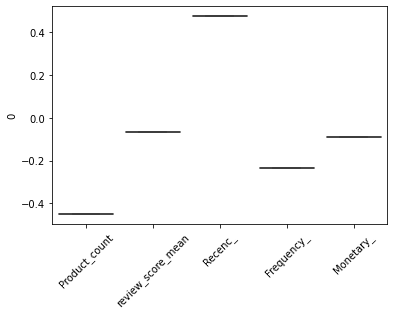

In [38]:
ax = sns.boxplot(x = kT.index, y = 0, data = kT)
plt.setp(ax.get_xticklabels(), rotation=45)


[None, None, None, None, None, None, None, None, None, None]

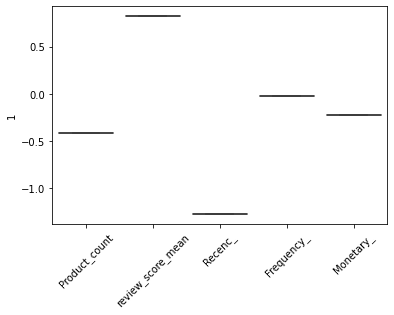

In [39]:
ax = sns.boxplot(x = kT.index, y = 1, data = kT)
plt.setp(ax.get_xticklabels(), rotation=45)

[None, None, None, None, None, None, None, None, None, None]

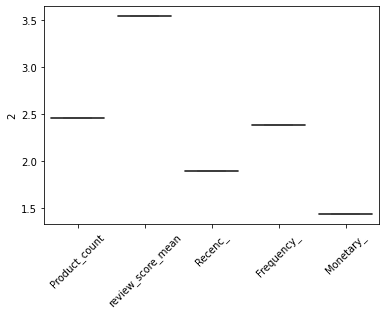

In [40]:
ax = sns.boxplot(x = kT.index, y = 2, data = kT)
plt.setp(ax.get_xticklabels(), rotation=45)

[None, None, None, None, None, None, None, None, None, None]

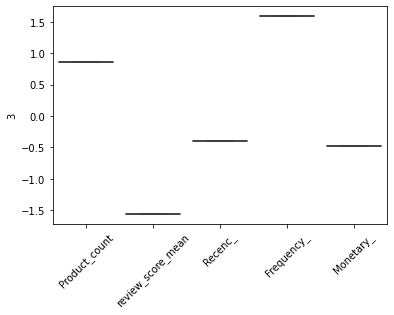

In [41]:
ax = sns.boxplot(x = kT.index, y = 3, data = kT)
plt.setp(ax.get_xticklabels(), rotation=45)

[None, None, None, None, None, None, None, None, None, None]

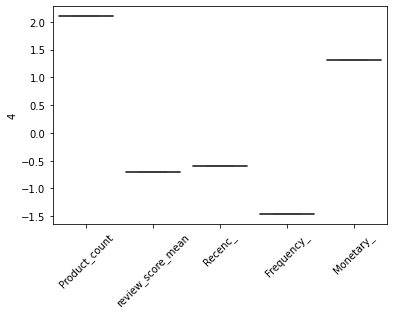

In [44]:
ax = sns.boxplot(x = kT.index, y = 4, data = kT)
plt.setp(ax.get_xticklabels(), rotation=45)

In [66]:
kTS = preprocessing.StandardScaler().fit(kT)
kTSX = kTS.transform(kT)
kTSX = pd.DataFrame(kTSX)
kTSX



,0,1,2,3,4
0,-1.227817,-0.287534,0.171500,0.779756,1.465411
1,0.022332,1.546639,1.702920,-1.419339,-0.622319
2,1.791925,-1.560600,-0.643235,-0.363075,-0.541633
3,-0.526689,0.299594,0.054852,1.434863,-1.181866
4,-0.059751,0.001900,-1.286037,-0.432205,0.880406


In [67]:
import plotly.express as px
import pandas as pd

# ------- 0 ------- 
df = pd.DataFrame(dict(r=kT[0],theta=kT.index))
fig = px.line_polar(df, r='r', theta='theta', line_close=True)
fig.show()

In [68]:
df = pd.DataFrame(dict(r=kT[1],theta=kT.index))
fig = px.line_polar(df, r='r', theta='theta', line_close=True)
fig.show()

In [69]:
df = pd.DataFrame(dict(r=kT[2],theta=kT.index))
fig = px.line_polar(df, r='r', theta='theta', line_close=True)
fig.show()

In [70]:
df = pd.DataFrame(dict(r=kT[3],theta=kT.index))
fig = px.line_polar(df, r='r', theta='theta', line_close=True)
fig.show()

In [71]:
df = pd.DataFrame(dict(r=kT[4],theta=kT.index))
fig = px.line_polar(df, r='r', theta='theta', line_close=True)
fig.show()

# CENTROIDE

In [56]:
mBase_2 = mBase_.rename(columns={0: 'Product_count',1 : 'review_score_mean',2 : 'Recenc_', 3:"Frequency_",4:"Monetary_"})
x = pd.DataFrame(_kMeans_pca.cluster_centers_)
centers = pd.DataFrame(_kMeans_pca.cluster_centers_)
centersT = centers.T
centersT = centersT[[0,1]]
centersT

,0,1
0,-0.448981,-0.414489
1,-0.066879,0.820959
2,0.473989,-1.271991
3,-0.234685,-0.019016
4,-0.091967,-0.219534
5,-0.003070,0.003684


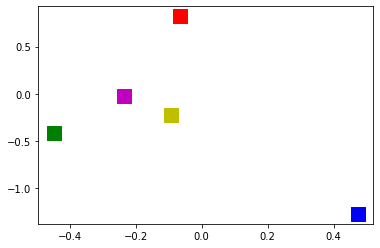

In [64]:
#plt.scatter(X[ : , 0], X[ : , 1], s =50, c=’b’)
plt.scatter(centersT.iloc[0][0],  centersT.iloc[0][1], s=200, color='g', marker='s')
plt.scatter(centersT.iloc[1][0],  centersT.iloc[1][1], s=200, color='r', marker='s')
plt.scatter(centersT.iloc[2][0],  centersT.iloc[2][1], s=200, color='b', marker='s')
plt.scatter(centersT.iloc[3][0],  centersT.iloc[3][1], s=200, color='m', marker='s')
plt.scatter(centersT.iloc[4][0],  centersT.iloc[4][1], s=200, color='y', marker='s')
plt.show()

# Stabilité dans le temps

0.3469002041821131
0.3833997137306029
0.38449158592169613
0.3623031076596684
0.3433904454680472
0.41787022234866644
0.5182031673999502
0.5924637999916691
0.6473412575037634
0.7337148435876025


(0.0, 9.0)

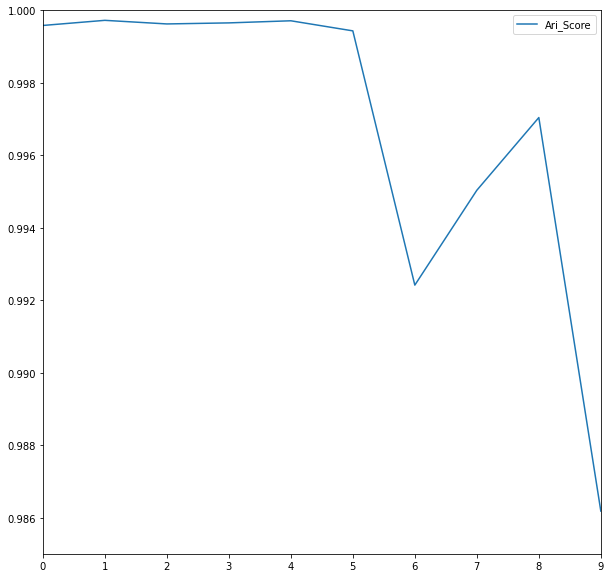

In [75]:
def kmeans_lab(cdc,x) : 

    mBase_1_0 = np.log(cdc[['Product_count','review_score_mean','Recenc_','Frequency_','Monetary_']])
    std_scale = preprocessing.StandardScaler().fit(mBase_1_0)
    X_scaled = std_scale.transform(mBase_1_0)
    mBase_1_0 = pd.DataFrame(X_scaled)
    
    mAllDum = pd.get_dummies(cdc[['product_category_name','Coord']])
    mAllDum = mAllDum.reset_index()
    mAllDum.drop("index", inplace=True, axis=1)
    mBase_2_0 = mAllDum.copy()
    
    mBase_ = mBase_1_0.join(mBase_2_0)
    
    km_base = KMeans(n_clusters=5, random_state=x, n_init=100)
    _kMeans_fit = km_base.fit(mBase_)
    lab = _kMeans_fit.labels_
    return lab

def kmeans_lab_for_X(cdc,rdm,t) : 

    mBase_1_0 = np.log(cdc[['Product_count','review_score_mean','Recenc_','Frequency_','Monetary_']])
    std_scale = preprocessing.StandardScaler().fit(mBase_1_0)
    X_scaled = std_scale.transform(mBase_1_0)
    mBase_1_0 = pd.DataFrame(X_scaled)
    
    mAllDum = pd.get_dummies(cdc[['product_category_name','Coord']])
    mAllDum = mAllDum.reset_index()
    mAllDum.drop("index", inplace=True, axis=1)
    mBase_2_0 = mAllDum.copy()
    
    mBase_ = mBase_1_0.join(mBase_2_0)
    
    km_base = KMeans(n_clusters=5, random_state=rdm, n_init=100)
    _kMeans_fit = km_base.fit(mBase_)
    lab = _kMeans_fit.labels_
    lab_df = pd.DataFrame(lab)
    lab_df = lab_df.join(mBase["Recenc_"])
    lab_df = lab_df.loc[(mBase['Recenc_'] < t)]
    lab_df = lab_df[0]
    lab_df = lab_df.to_numpy()
    return lab_df


def yyy(yyy1, rmd, t):
    y1 = mBase.loc[(mBase['Recenc_'] < t)]
    y1 = kmeans_lab(y1,rmd)
    return y1


x_1 = kmeans_lab_for_X(mBase,1, 30)
x_2 = kmeans_lab_for_X(mBase,1, 60)
x_3 = kmeans_lab_for_X(mBase,1, 90)
x_4 = kmeans_lab_for_X(mBase,1, 120)
x_5 = kmeans_lab_for_X(mBase,1, 150)
x_6 = kmeans_lab_for_X(mBase,1, 180)
x_7 = kmeans_lab_for_X(mBase,1, 210)
x_8 = kmeans_lab_for_X(mBase,1, 240)
x_9 = kmeans_lab_for_X(mBase,1, 270)
x_10 = kmeans_lab_for_X(mBase,1, 300)
x_11 = kmeans_lab_for_X(mBase,1, 330)
x_12 = kmeans_lab_for_X(mBase,1, 360)
x_13 = kmeans_lab_for_X(mBase,1, 390)
x_14 = kmeans_lab_for_X(mBase,1, 420)
x_15 = kmeans_lab_for_X(mBase,1, 450)
x_16 = kmeans_lab_for_X(mBase,1, 480)
x_17 = kmeans_lab_for_X(mBase,1, 510)
x_18 = kmeans_lab_for_X(mBase,1, 540)
x_19 = kmeans_lab_for_X(mBase,1, 570)
x_20 = kmeans_lab_for_X(mBase,1, 600)


y_1 =  yyy(mBase,1, 30)
y_2 =  yyy(mBase,1, 60)
y_3 =  yyy(mBase,1, 90)
y_4 =  yyy(mBase,1, 120)
y_5 =  yyy(mBase,1, 150)
y_6 =  yyy(mBase,1, 180)
y_7 =  yyy(mBase,1, 210)
y_8 =  yyy(mBase,1, 240)
y_9 =  yyy(mBase,1, 270)
y_10 = yyy(mBase,1, 300)
y_11 = yyy(mBase,1, 330)
y_12 = yyy(mBase,1, 360)
y_13 = yyy(mBase,1, 390)
y_14 = yyy(mBase,1, 420)
y_15 = yyy(mBase,1, 450)
y_16 = yyy(mBase,1, 480)
y_17 = yyy(mBase,1, 510)
y_18 = yyy(mBase,1, 540)
y_19 = yyy(mBase,1, 570)
y_20 = yyy(mBase,1, 600)

print(adjusted_rand_score(x_1,y_1))
print(adjusted_rand_score(x_2,y_2))
print(adjusted_rand_score(x_3,y_3))
print(adjusted_rand_score(x_4,y_4))
print(adjusted_rand_score(x_5,y_5))
print(adjusted_rand_score(x_6,y_6))
print(adjusted_rand_score(x_7,y_7))
print(adjusted_rand_score(x_8,y_8))
print(adjusted_rand_score(x_9,y_9))
print(adjusted_rand_score(x_10,y_10))


ari = { 'Ari_Score': [
0.9995788122738561,
0.9997203242312541,
0.9996209535421804,
0.9996497960414398,
0.9997080380210149,
0.9994297442920459,
0.9924140771034631,
0.9950311663203503,
0.99703778841613,
0.9861784114525296]}

mDf_Ari = pd.DataFrame(ari, columns = ['Ari_Score'])

from matplotlib.pyplot import figure
figure(figsize=(10, 10))
sns.lineplot(data=mDf_Ari)
plt.ylim(0.985, 1)
plt.xlim(0,9)

In [ ]:
sound_file_1 = '/Users/soso/Downloads/Batterie de blague.mp3.mp3'
Audio(sound_file_1, autoplay=True)